In [1]:
# import json
# import pandas as pd



# works = ["A","B"]
# real_work = {"A":"rec_grapheme_label_C_B", "B":"rec_grapheme_label_C+IMF_B"}
# real_work = {"A":"rec___ABI_A___aihub_rec_50k_horizontal___G___scratch", "B":"rec_grapheme_label_C+rec___ABI_A___aihub_rec_50k_horizontal___C___scratch"}

# label_file = "/home/labelsets/aihub_rec_50k_horizontal_80:10:10/test_label.txt"

# data = dict()

# def get_infer_result(result):
#     return json.loads(result)["Align3"]["character"][0][0]
#     return json.loads(result)["Vision"]["Character"][0][0]

# with open(label_file, "r") as f:
#     lines = [line.split("\t") for line in f.readlines()]
#     data["image"] = [line[0] for line in lines]
#     data["label"] = [line[1].strip() for line in lines]

    
# for work in works:
#     infer_file = f"/home/works/{real_work[work]}/inference_result"

#     with open(infer_file, "r") as f:
#         lines = [json.loads(line.split("\t")[1].strip()) for line in f.readlines()]
#         print(lines[0])
#         data[f"{work}_Vision"] = [line["vision"]["character"][0][0] for line in lines]
#         data[f"{work}_Align1"] = [line["align1"]["character"][0][0] for line in lines]
#         data[f"{work}_Align2"] = [line["align2"]["character"][0][0] for line in lines]
#         data[f"{work}_Align3"] = [line["align3"]["character"][0][0] for line in lines]
        

# min_len = min([len(d) for d in data.values()])
# for k, v in data.items():
#     data[k] = v[:min_len]

# df = pd.DataFrame(data)


# for column in df.columns[1:]:
#     df[column] = df[column].apply(lambda x : x.replace(" ", ""))

IndexError: list index out of range

In [4]:
import numpy as np
from typing import List, Optional, Union


from rapidfuzz.distance import Levenshtein

initial_list = ['가', '까', '나', '다', '따', '라', '마', '바', '빠', '사', '싸', '아', '자', '짜', '차', '카', '타', '파', '하']
medial_list = ['아', '애', '야', '얘', '어', '에', '여', '예', '오', '와', '왜', '외', '요', '우', '워', '웨', '위', '유', '으', '의', '이']
final_list = ['으', '윽', '윾', '윿', '은', '읁', '읂', '읃', '을', '읅', '읆', '읇', '읈', '읉', '읊', '읋', '음', '읍', '읎', '읏', '읐', '응', '읒', '읓', '읔', '읕', '읖', '읗']

def _decompose_korean_char(char):
    # 한글 유니코드 시작: 44032, 끝: 55199
    if not 44032 <= ord(char) <= 55199:
        return char, char, char
    
    # 한글 자모 시작 유니코드
    initial = 44032  # '가'의 유니코드
    
    # 초성, 중성, 종성 계산
    code = ord(char) - initial
    initial_index = code // 588
    medial_index = (code - initial_index * 588) // 28
    final_index = code % 28
    
    return [initial_list[initial_index], medial_list[medial_index], final_list[final_index]]

def decompose_korean_char(text):
    decomposed = [_decompose_korean_char(c) for c in text]
    return {
        "initial":"".join([x[0] for x in decomposed]),
        "medial":"".join([x[1] for x in decomposed]),
        "final":"".join([x[2] for x in decomposed])
    }
    
def _compose_korean_char(initial, medial, final, initial_p=None, medial_p=None, final_p=None):
    if (final is None) or (medial is None) or (initial is None):
        return [" ", 0]
    
    initial_p = 0 if initial_p is None else initial_p
    medial_p = 0 if medial_p is None else medial_p
    final_p = 0 if final_p is None else final_p
    
    # try:
    initial_index = initial_list.index(initial) if (initial is not None) and (initial in initial_list) else None
    medial_index = medial_list.index(medial) if (medial is not None) and (medial in medial_list) else None
    final_index = final_list.index(final) if (final is not None) and (final in final_list) else None
    
    # 자소가 1개 이하인 경우 => 그나마 가장 괜찮을 걸로 대체
    if [initial_index, medial_index, final_index].count(None) >= 2:
        grapheme = [initial, medial, final]
        p = [initial_p, medial_p, final_p]
        idx = np.array(p).argmax()
        return [grapheme[idx], p[idx]]
    
    # 자소가 2개 이상인 경우 => 자소가 아닌 녀석만 기본 자소로 사용
    else:
        initial_index = initial_index if initial_index is not None else 11
        medial_index = medial_index if medial_index is not None else 0
        final_index = final_index if final_index is not None else 0
        
    char_code = 44032 + (initial_index * 21 + medial_index) * 28 + final_index
    return [chr(char_code), sum([initial_p, medial_p, final_p])/3]

def compose_korean_char(initial: Union[str, List[str]],  
                        medial: Union[str, List[str]], 
                        final: Union[str, List[str]], 
                        initial_p: Union[List[float], float, None] = None, 
                        medial_p: Union[List[float], float, None] = None, 
                        final_p: Union[List[float], float, None] = None):
    
    def preprocessing_of_prob(text, p):
        """_summary_

        Args:
            p [None, int, list]: character에 대한 확률 값 (문자열 전체애 대한 확률인 경우 int, 각 글자에 대한 확률인 경우 [int, ...])
            l int: 문자열 길이 
        Returns:
            [int, ...]: 각 글자에 대한 확률 값으로 변환
        """
        
        if p is None:
            return [None for _ in range(len(text))] # 각 글자마다 확률 None
        elif isinstance(p, int):
            return [p for _ in range(len(text))] # 각 글자에 동일한 확률값 배정
        else:
            return p
        
    # 확률값을 글자 당 확률 형태로 통일        
    initial_p = preprocessing_of_prob(initial, initial_p)    
    medial_p = preprocessing_of_prob(medial, medial_p)
    final_p = preprocessing_of_prob(final, final_p)
    
    text_list, conf_list = [], []
    for i, m, f, ip, mp, fp in list(zip(initial, medial, final, initial_p, medial_p, final_p)):
        text, conf = _compose_korean_char(i, m, f, ip, mp, fp)
        text_list.append(text)
        conf_list.append(conf)
    
    if len(text_list) == 0:
        return " ", 0
    return ["".join(text_list), conf_list]

def grapheme_edit_dis(x, y):
    _x, _y = x, y
    if len(x) == 0 or len(y) == 0:
        if len(x) == len(y):
            return 1
        else:
            return 0
        
    x = decompose_korean_char(x)
    y = decompose_korean_char(y)
    # x = "".join(["".join(v) if len(set(v)) > 1 else v[0] for v in x])
    # y = "".join(["".join(v) if len(set(v)) > 1 else v[0] for v in y])
    
    x = "".join(["".join(v) for v in x])
    y = "".join(["".join(v) for v in y])
    # print(_x, _y, 1 - Levenshtein.normalized_distance(x, y))
    return Levenshtein.normalized_distance(x, y)

def test_addition():
    assert _decompose_korean_char("한") == ["하", "아", "은"]
    assert decompose_korean_char("한명훈") == {"initial":"하마하", "medial":"아여우", "final":"은응은"}
    assert decompose_korean_char("a") == {"initial":"a", "medial":"a", "final":"a"}
    
    assert _compose_korean_char("하", "아", "은", 1, 1, 1) == ["한", 1.0]
    assert compose_korean_char(["하"], ["아"], ["은"], [1.0], [1.0], [1.0]) == ["한", 1.0]
    assert compose_korean_char(["하", "마", "하"], ["아", "여", "우"], ["은", "응", "은"], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0]) == ["한명훈", 1.0]
    


if __name__ == "__main__":
    print(grapheme_edit_dis("abc", "abd"))
    
# Character group:      [Character elements, ...]                                       composition arguments of character group
# Element group:        [Initials, Medials, Finals, Initials_p, Medials_p, Finals_p]    composition arguments of element group
# Character elements:   [Initial, Medial, Final, Initial_p, Medial_p, Final_p]                                                         ex) ["하", "아", "은", 1, 1, 1]
# Initials:             [Initial, ...]                                                                                                 ex) ["하", "마", "하"]
# Medials:              [Medial, ...]                                                                                                  ex) ["아", "여", "우"]
# Finals:               [Final, ...]                                                                                                   ex) ["은", "응", "은"]
# Initial:              char                                                            Initial
# Medial:               char                                                            Medial
# Final:                char                                                            Final
# Initial_p:            int                                                             Initial probability
# Medial_p:             int                                                             Medial probability
# Final_p:              int                                                             Final probability


0.0


In [5]:
import json
import pandas as pd
import os

new_path = "/home/code/PaddleOCR/ppocr"

if "PYTHONPATH" in os.environ:
    os.environ["PYTHONPATH"] = new_path + os.pathsep + os.environ["PYTHONPATH"]
else:
    os.environ["PYTHONPATH"] = new_path

print(os.environ["PYTHONPATH"])



def make_label_df(label_file):
    with open(label_file, "r") as f:
        lines = [line.strip("\n").split("\t") for line in f.readlines()]
        labels = [{"image":f"/home/datasets/{line[0]}", "label":line[1]} for line in lines]
        
    for label in labels:
        label["character"] = label["composed"]= label["label"].replace(" ", "")
        decomposed = decompose_korean_char(label["label"])
        label.update(decomposed)
    
    new_samples = list()
    for label in labels:
        for target in ["character", "initial", "medial", "final", "composed"]:
            new_samples.append({"image":label["image"], "target":target, "label":label[target]})
    
    return pd.DataFrame(new_samples)



def make_df(work, label_df):
    infer_file = f"/home/works/{work}/inference_result"

    preds = list()

    with open(infer_file, "r") as f:
        lines = [line.strip().split("\t") for line in f.readlines()]
        
        for line in lines:        
            image, pred = line[0], json.loads(line[1]) 
            pred["image"] = image
            preds.append(pred)

    new_samples = []

    for pred in preds:
        image = pred["image"]
        del pred["image"]
        for model_name, v in pred.items():
            for target_name, pred in v.items():
                sample = dict()
                sample["id"] = work
                sample["image"] = image
                sample["model"] = model_name
                sample["target"] = target_name
                sample["text"] = pred[0][0].replace(" ", "")
                sample["prob"] = pred[0][1]
                new_samples.append(sample)
        
    df =  pd.DataFrame(new_samples)
    return pd.merge(label_df, df, on=["image", "target"])



label_file = "/home/datasets/aihub_rec/clean_label.txt"
works = ["rec___ABI_A___aihub_rec_50k_horizontal___G___scratch", "rec___ABI_A___aihub_rec_50k_horizontal___C___scratch"]
works = ["rec___ABI_A___aihub_rec_full_horizontal___G___scratch"]



label_df = make_label_df(label_file)


# df_list = [make_df(work, label_df) for work in works]
# df = pd.concat(df_list)


# df_dict = {k:df[df["id"] == k] for k in df["id"].unique()}
# df1 = df_dict["rec___ABI_A___aihub_rec_50k_horizontal___G___scratch"]
# df1 = df1[df1["target"] == "composed"]
# df2 = df_dict["rec___ABI_A___aihub_rec_50k_horizontal___C___scratch"]
# df2 = df2[df2["target"] == "character"]

/home/code/PaddleOCR/ppocr:/home/code/PaddleOCR/ppocr:/home/code/PaddleOCR/ppocr:/home/code:


In [19]:
unique = ['h', 'p', 'v', '굄', '꼈', '뀀', '끎', '놉', '땍', '뗐', '똔', '럷', '뼝', '삑', '쉭', '왱', '읿', '잰', '쭘', '췄', '텁', '툽', '픅', '홧', '홯', '훨']

In [39]:
df = df_list[0]
df["answer"] = df["label"] == df["text"]
df[(df["target"] == "composed") & (df["model"] == "align3") & (df["label"] != df["text"])][["label", "text", "answer", "image"]]

# df[(df["target"] == "composed") & (df["model"] == "align3")][["label", "text", "answer"]]
# df[(df["target"] == "composed") & (df["model"] == "align3") & (df["label"] != df["text"])]

# df2 = df[(df["target"] == "composed") & (df["model"] == "align3")][["label", "text", "answer"]]

# answer_unique = []
# for i, (label, text, answer) in enumerate(zip(df2["label"], df2["text"], df2["answer"])):
#     for x in text:
#         if x in unique:
#             answer_unique.append(x)

# set(answer_unique)

,label,text,answer,image
83,토박이뀀성,토박이퓀성,False,/home/datasets/aihub_rec/199/198876.png
111,ghl,회,False,/home/datasets/aihub_rec/731/730982.png
139,삑사리코인노래연습장,벡사리코인노래연습장,False,/home/datasets/aihub_rec/107/106751.png
195,형제픅판보드,형제흑판보드,False,/home/datasets/aihub_rec/185/184260.png
223,주쉭회사,주식회사,False,/home/datasets/aihub_rec/538/537209.png
279,클럷,클럽,False,/home/datasets/aihub_rec/592/591932.png
307,뼝뼝,병병,False,/home/datasets/aihub_rec/484/483779.png
363,v,부동산,False,/home/datasets/aihub_rec/776/775547.png
391,네읿,네일,False,/home/datasets/aihub_rec/238/237805.png
531,rhkddlftpxkrth,광일세탁소,False,/home/datasets/aihub_rec/57/56065.png


['/home/datasets/aihub_rec/199/198876.png',
 '/home/datasets/aihub_rec/731/730982.png',
 '/home/datasets/aihub_rec/107/106751.png',
 '/home/datasets/aihub_rec/185/184260.png',
 '/home/datasets/aihub_rec/538/537209.png',
 '/home/datasets/aihub_rec/592/591932.png',
 '/home/datasets/aihub_rec/484/483779.png',
 '/home/datasets/aihub_rec/776/775547.png',
 '/home/datasets/aihub_rec/238/237805.png',
 '/home/datasets/aihub_rec/57/56065.png',
 '/home/datasets/aihub_rec/248/247855.png']

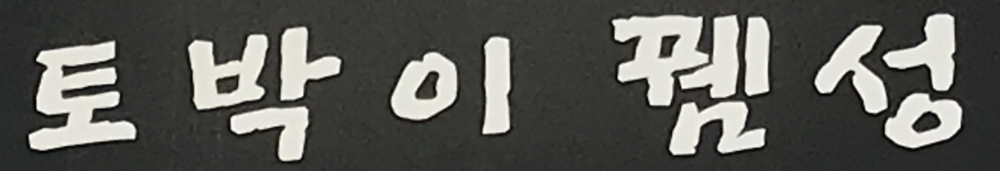

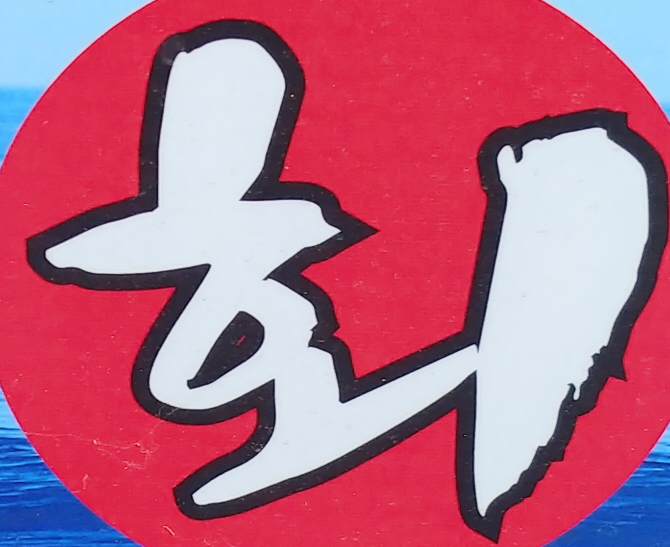

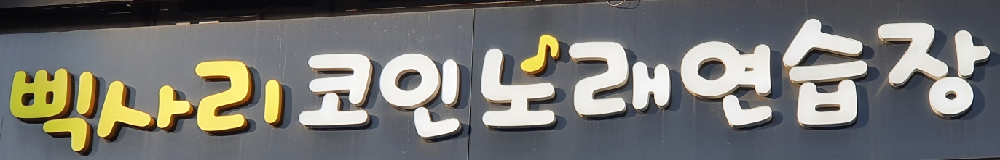

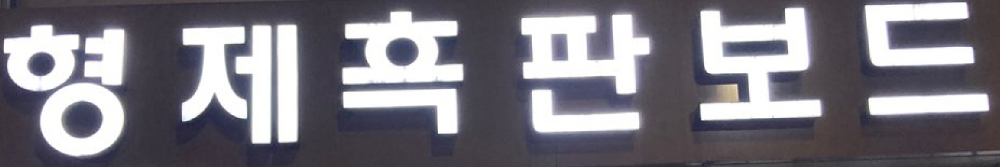

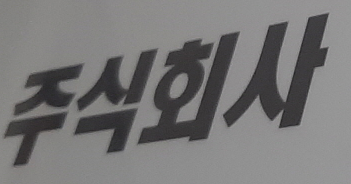

...

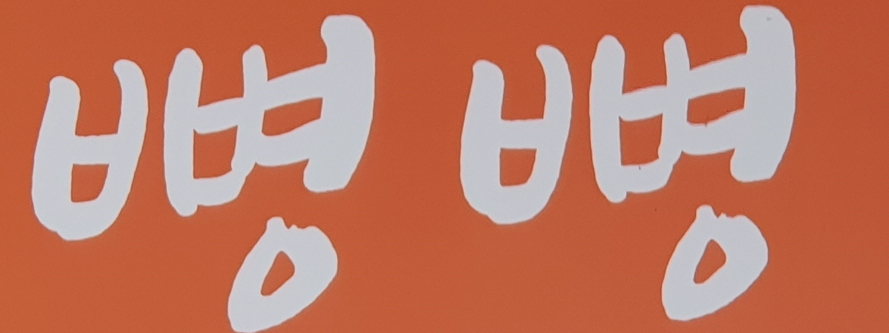

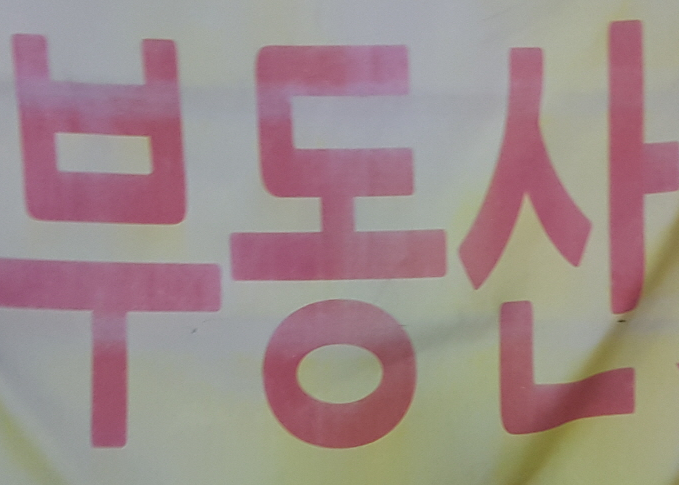

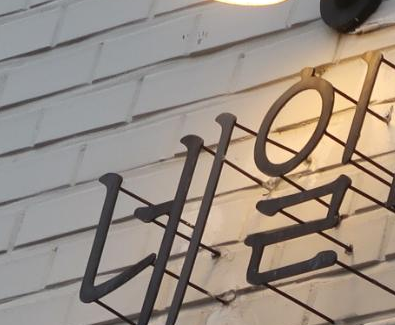

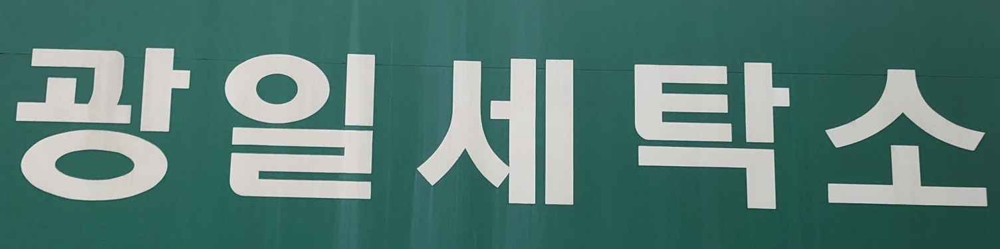

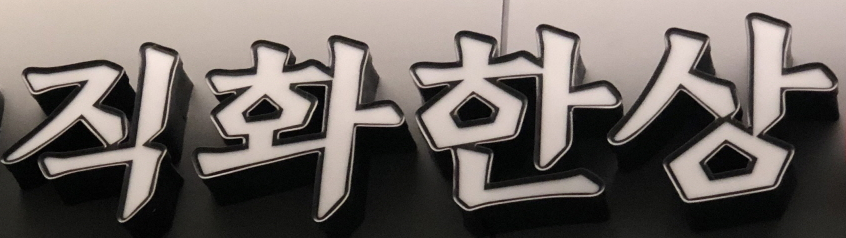

In [38]:
from PIL import Image
for x in a:
    Image.open(x).show()

In [34]:
with open("/home/error.txt") as f:
    error_list = [line.strip("\n").split("\t")[0] for line in f.readlines()]

In [40]:
from sys import prefix
import pandas as pd
from PIL import Image
import queue


df = pd.merge(df1, df2, on=["image", "label", "model"], suffixes =["_G", "_C"])
model = "vision"
model = "align3"

df = df[df["model"] == model]
df["true_g"] = df["label"] == df["text_G"]
df["true_c"] = df["label"] == df["text_C"]
df = df[["image", "label", "text_G", "text_C", "true_g", "true_c"]]

result = dict()

for g_flag in [True, False]:
    for c_flag in [True, False]:
        result[f"{g_flag}_{c_flag}"] = len(df[(df["true_g"] == g_flag) & (df["true_c"] == c_flag)])

result

{'True_True': 3239, 'True_False': 253, 'False_True': 358, 'False_False': 696}

In [1]:

# pd.DataFrame(result)

df[(df["true_g"] == False) & (df["true_c"] == False)]

a = 0
q = queue.Queue()

for i, row in df[(df["true_g"] == False) & (df["true_c"] == False)].iterrows():
    if i < 0:
        continue
    if row["image"] in error_list:
        continue
    print(i, row["image"], "|", row["label"], "|",row["text_G"], "|", row["text_C"])
    Image.open( row["image"]).resize((100, 50)).show()
    q.put(f"{i}\t{row['image']}\t{row['label']}\n")
    
    a+=1
    if a > 3:
        log = q.get()
        x = input()
        if x == " ":
            
            
            with open("/home/error.txt", "a") as f:
                f.write(log)
        elif x == "s":
            break
        

In [3]:

































q = queue.Queue()
q.put(1)
q.put(2)

print(q.get())
print(q.get())
print(q.get())

1
2


KeyboardInterrupt: 

In [179]:
from PIL import Image


target_df = df[(df["label"] == df["A_align3"]) & (df["label"] == df["B_align3"])]
true = len(target_df)
print(true)


target_df = df[(df["label"] != df["A_align3"]) & (df["label"] == df["B_align3"])]
left_wrong = len(target_df)
print(left_wrong)


target_df = df[(df["label"] == df["A_align3"]) & (df["label"] != df["B_align3"])]
right_wrong = len(target_df)
print(right_wrong)


target_df = df[(df["label"] != df["A_align3"]) & (df["label"] != df["B_align3"])]
both_wrong = len(target_df)
print(both_wrong)

print("total =", left_wrong + right_wrong + both_wrong)

target_df

32129
547
385
1066
total = 1998


,image,label,A_vision,A_align1,A_align2,A_align3,B_vision,B_align1,B_align2,B_align3
25,aihub_rec/763/762933.png,감각더헤어,감갇더헤어,감갇더헤어,감갇더헤어,감갇더헤어,감각더헤어,감갇더헤어,감갇더헤어,감갇더헤어
57,aihub_rec/843/842254.png,생활속의,마틀는,마패는,마루는,마루는,일랑로,중봉로,공봉로,중봉로
124,aihub_rec/835/834713.png,인생을바꾸는,도도을지지,도상을지든,도상을지든,도상을지든,읽는아,읽바기,읽바기기,독바기
133,aihub_rec/814/813729.png,어쩌다,악악하,우라하,예라하는,예라하는,여음,오석,오른,오른
150,aihub_rec/341/340744.png,방ㄹ,방,방,방,방,방,방,방,방
...,...,...,...,...,...,...,...,...,...,...
33966,aihub_rec/554/553674.png,이룸에스앤앤,이룸에스앤엔,이룸에스앤엔,이룸에스앤엔,이룸에스앤엔,이룸에스앤앤,이롬에스앤앤,이롬에스앤앤,이롬에스앤앤
33978,aihub_rec/177/176923.png,참치,강국약국국,과국약국,과국약국,과국약국,교로약국,교악약로,교악약료,음악약료
34016,aihub_rec/566/565792.png,노래빠,노래벨,노래빵,노래빵,노래빵,노래빵,노래빵,노래빵,노래빵
34056,aihub_rec/123/122235.png,이끎,이꿈,이꿈,이꿈,이꿈,이끓,이꿈,이꿈,이꿈


In [180]:
import sys
new_path = "/home/code/PaddleOCR"

if new_path not in sys.path:
    sys.path.append(new_path)
    
from ppocr.utils.korean_compose import grapheme_edit_dis

target_df = target_df.copy()
for c in target_df.columns[2:]:
    target_df[c] = target_df[["label", c]].apply(lambda x : grapheme_edit_dis(*x), axis=1)


,image,label,A_vision,A_align1,A_align2,A_align3,B_vision,B_align1,B_align2,B_align3
25,aihub_rec/763/762933.png,감각더헤어,0.066667,0.066667,0.066667,0.066667,0.000000,0.066667,0.066667,0.066667
57,aihub_rec/843/842254.png,생활속의,0.916667,1.000000,1.000000,1.000000,0.833333,0.750000,0.750000,0.750000
124,aihub_rec/835/834713.png,인생을바꾸는,0.722222,0.555556,0.555556,0.555556,0.722222,0.666667,0.666667,0.777778
133,aihub_rec/814/813729.png,어쩌다,0.666667,0.444444,0.583333,0.583333,0.666667,0.666667,0.666667,0.666667
150,aihub_rec/341/340744.png,방ㄹ,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000
...,...,...,...,...,...,...,...,...,...,...
33966,aihub_rec/554/553674.png,이룸에스앤앤,0.055556,0.055556,0.055556,0.055556,0.000000,0.055556,0.055556,0.055556
33978,aihub_rec/177/176923.png,참치,0.933333,0.916667,0.916667,0.916667,0.916667,0.833333,0.833333,0.833333
34016,aihub_rec/566/565792.png,노래빠,0.333333,0.111111,0.111111,0.111111,0.111111,0.111111,0.111111,0.111111
34056,aihub_rec/123/122235.png,이끎,0.333333,0.333333,0.333333,0.333333,0.166667,0.333333,0.333333,0.333333


In [183]:
target_df.mean()

/home/.venv/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  """Entry point for launching an IPython kernel.


A_vision    0.433688
A_align1    0.434698
A_align2    0.435991
A_align3    0.435404
B_vision    0.426907
B_align1    0.428153
B_align2    0.426004
B_align3    0.429189
dtype: float64

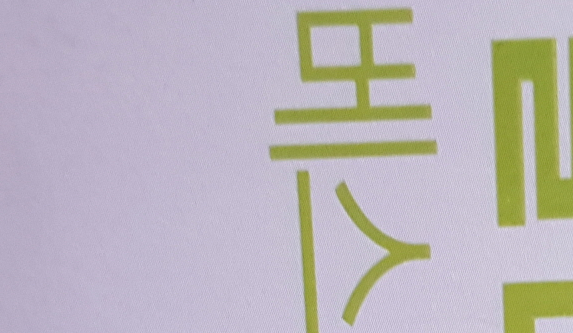

label: 일연, a: 하로수, b: 달상


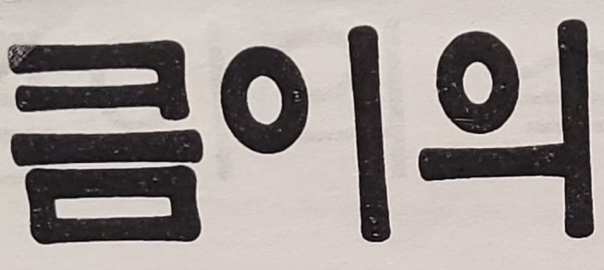

label: 큼이의, a: 금이의, b: 금이의


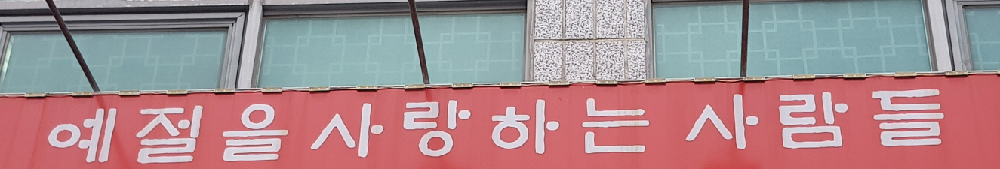

label: 예절을사랑하는사람들, a: 예정을사랑하는사람들, b: 예철을사랑하는사람들


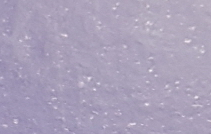

label: 것의, a: 가가, b: 혜학


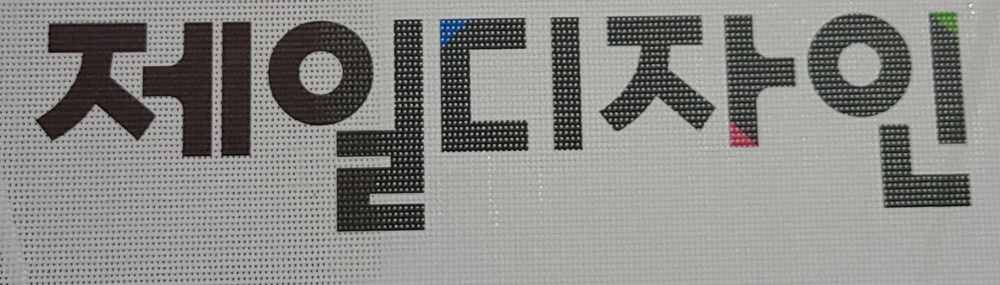

label: 재일디자인, a: 제일디자인, b: 제일디자인


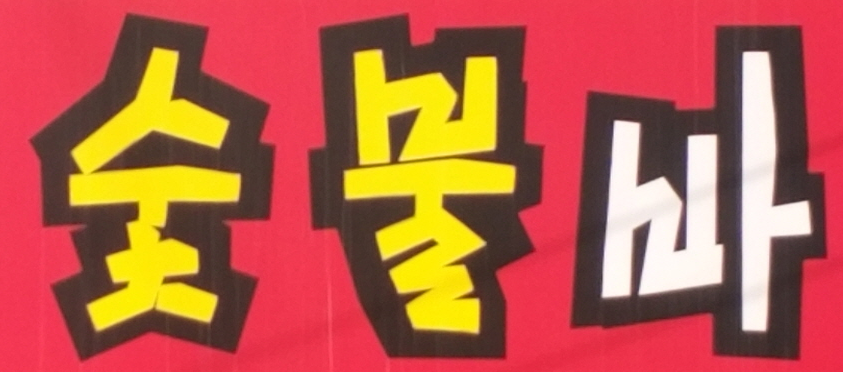

label: 숯불빠, a: 숯불바, b: 숯불


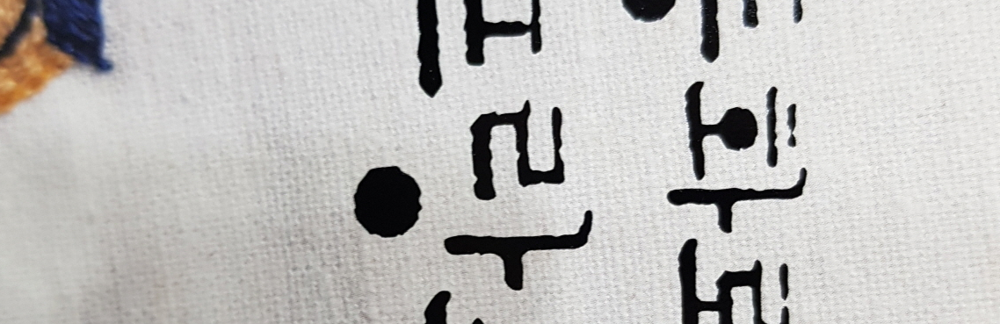

label: 프랑스자수, a: 프랑스자기, b: 프랑스만다


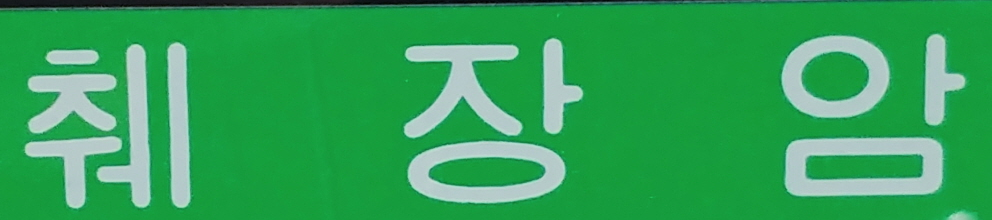

label: 췌장암, a: 례장암, b: 취장암


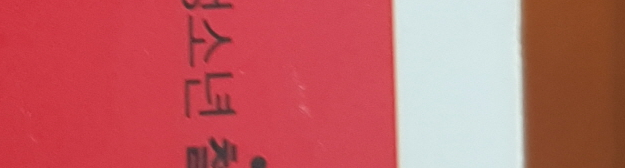

label: 사람속에서찾은, a: 박국사의사이의, b: 혼


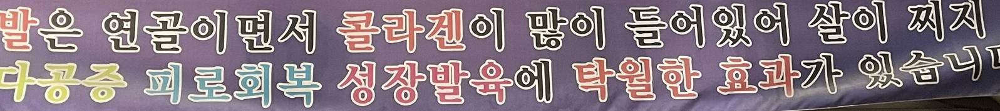

label: 진가네반찬, a: 정진진진진진진원원, b: 김국


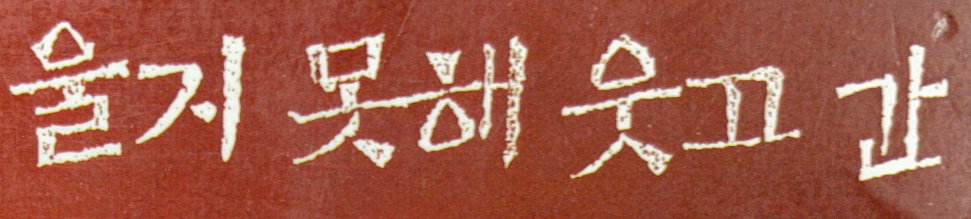

label: 울지못해웃고간, a: 울거못해웃고간, b: 울거못해웃고간


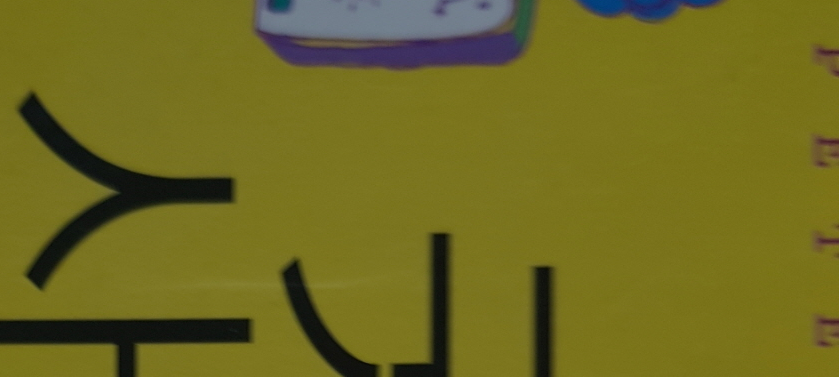

label: 굿모님, a: 스과, b: 가


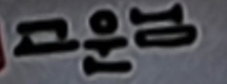

label: 고운님, a: 다운님, b: 교운념


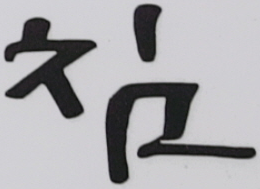

label: 침, a: 치, b: 참


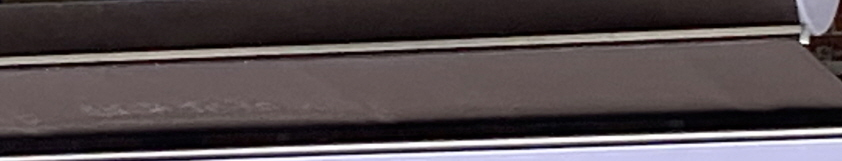

label: 쌍용동손세탁, a: 아크트, b: 아이비


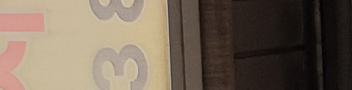

label: 강동팰리스, a: 광이모아아, b: 정정자의의의점점


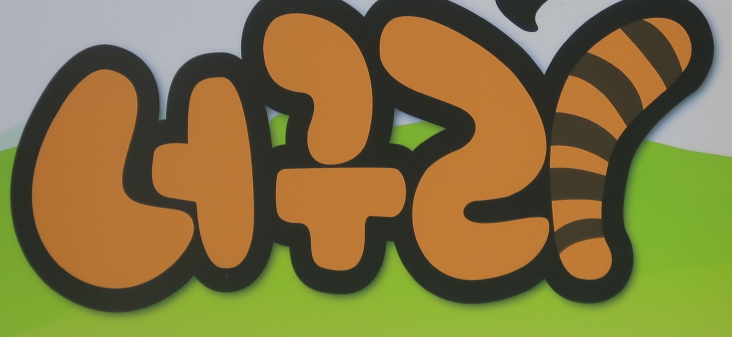

label: 너구리, a: 너구락, b: 너구령


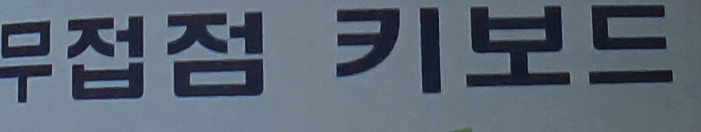

label: 무접점키보드, a: 무접키보드, b: 무점점키보드


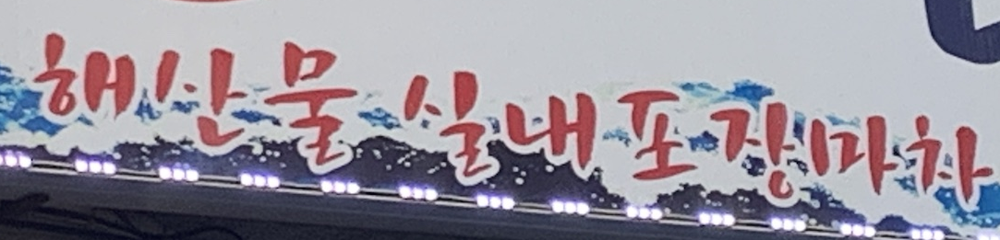

label: 해산물실내포장마차, a: 해산을실내포김마원, b: 해사묵북내포판마차


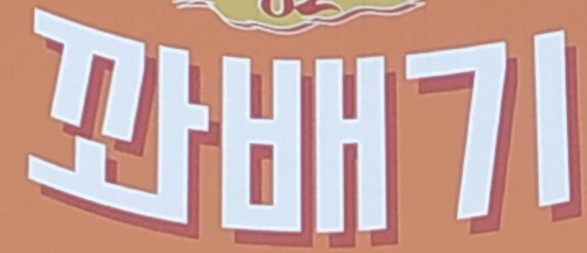

label: 꽈배기, a: 배기, b: 배기


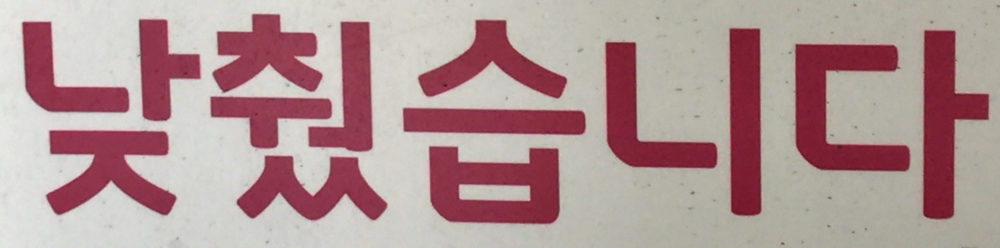

label: 낮췄습니다, a: 낮찾습니다, b: 낮갱습니다


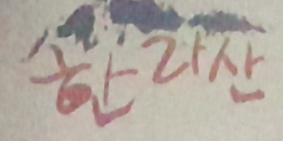

label: 한라산, a: 송촌리산, b: 한은산산


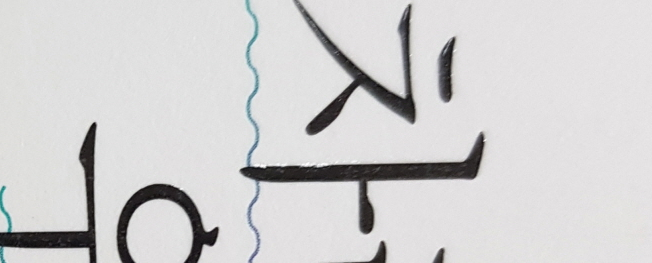

label: 우리, a: 시들들, b: 그하을


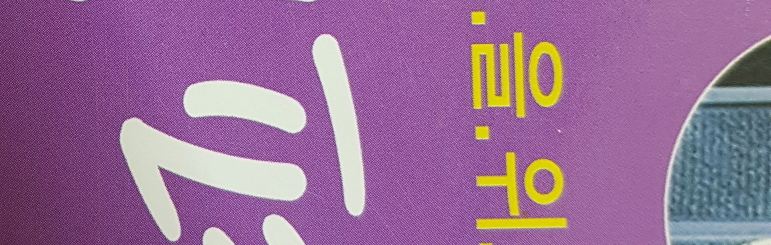

label: 이야기, a: 세세지, b: 세세에


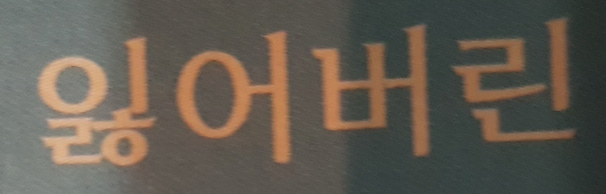

label: 읽어버린, a: 잃어버린, b: 잃어버린


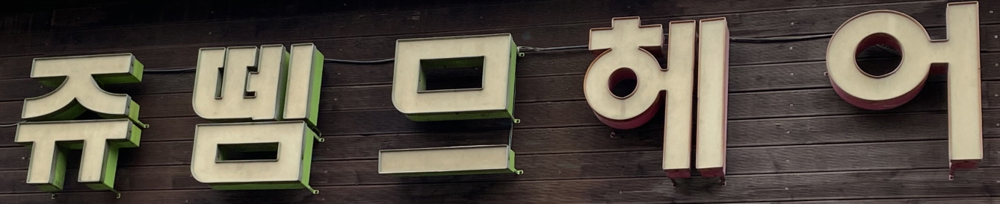

label: 쥬뗌므헤어, a: 쥬므헤헤, b: 쥬핑므헤


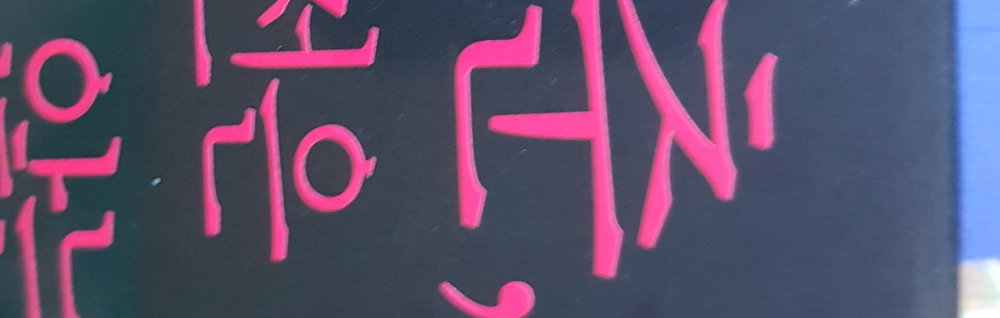

label: 지치지않는다, a: 갓한가다, b: 한신한다


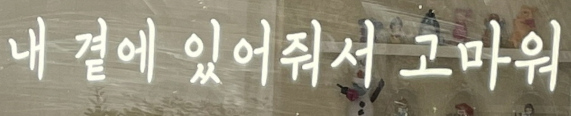

label: 내곁에있어줘서고마워, a: 내곁에있어줘고마워, b: 내곁에있어줘서그마워


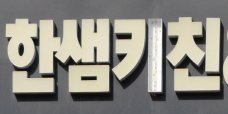

label: 한샘키친, a: 한샘키친친, b: 한샘친


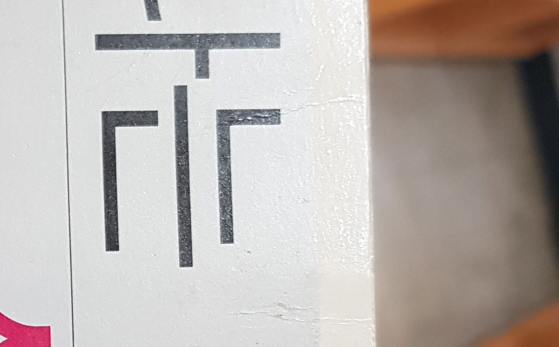

label: 수시, a: 관면실, b: 법각


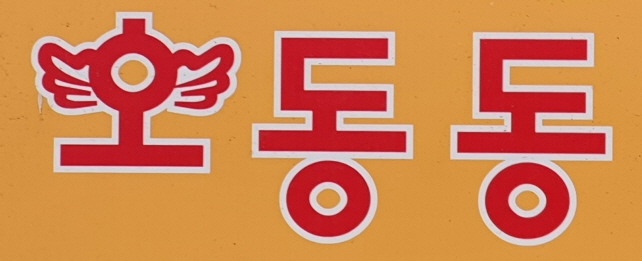

label: 오동동, a: 현동동, b: 초동동


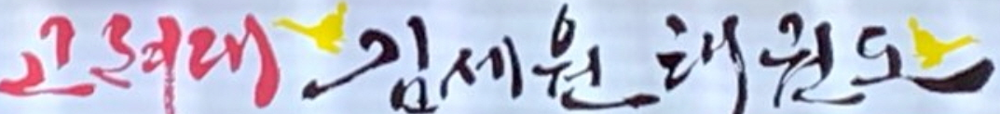

label: 고려대김세원태권도, a: 오에이크김사운태원도, b: 오뷔미김아를해한단


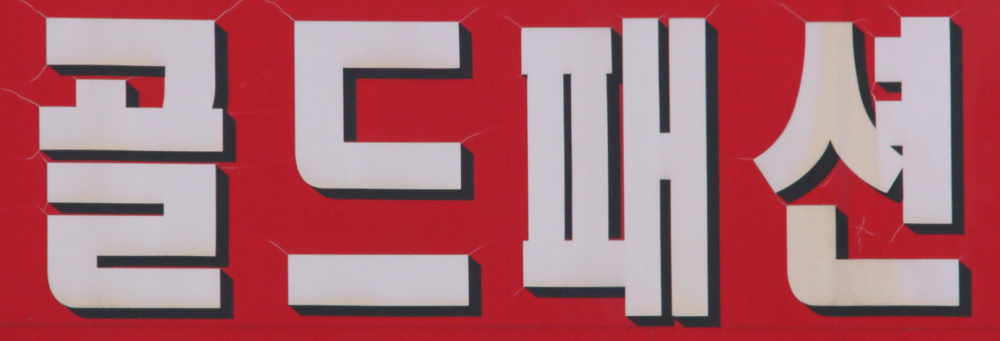

label: 골든패션, a: 골드패션, b: 골드패션


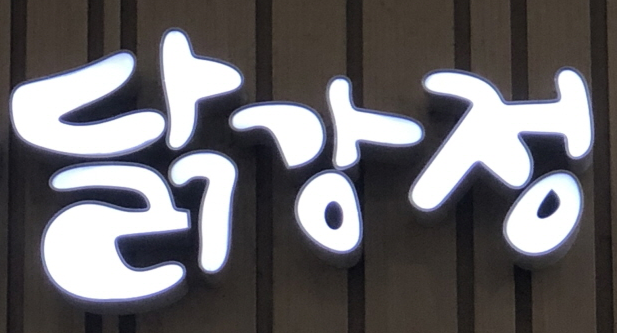

label: 닭간정, a: 닭강정, b: 닭강정


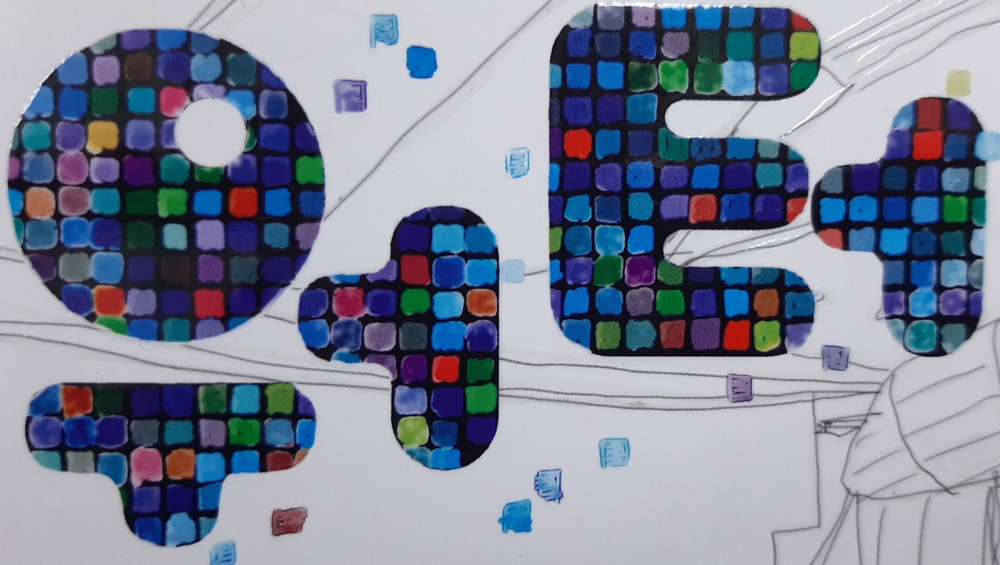

label: 워터, a: 무술래, b: 옥동고섬


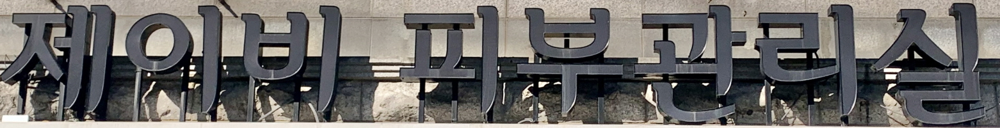

label: 제이비피부관리실, a: 페이방피부과리실, b: 페이라피부관리실


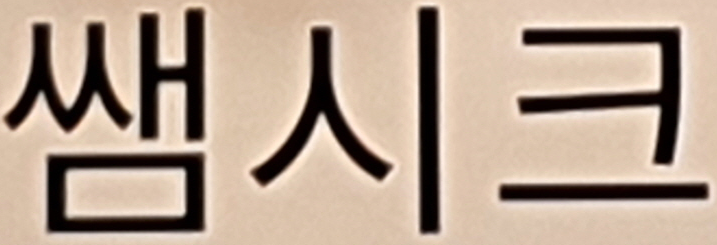

label: 쌤시크, a: 시크, b: 시크


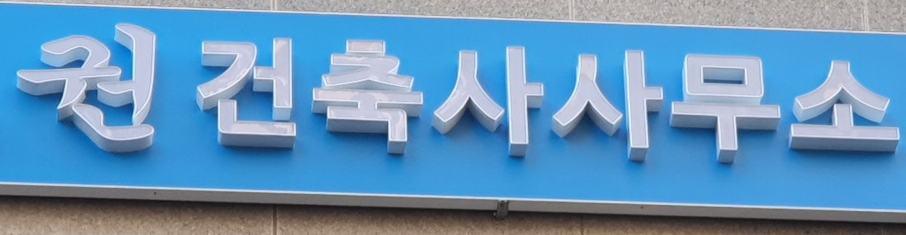

label: 권건축사사무소, a: 원건건축사사무소, b: 원건사사사무소


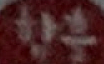

label: 함흥, a: 한우, b: 한우


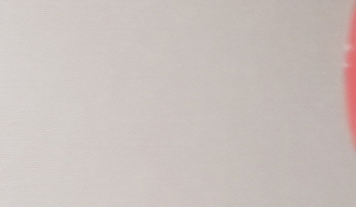

label: 빨간지구, a: 복음을, b: 사


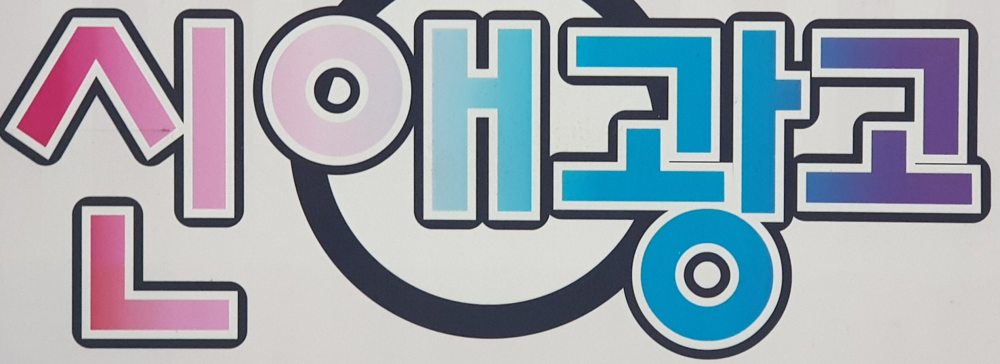

label: 신애광고, a: 신앤광고, b: 신앤광고


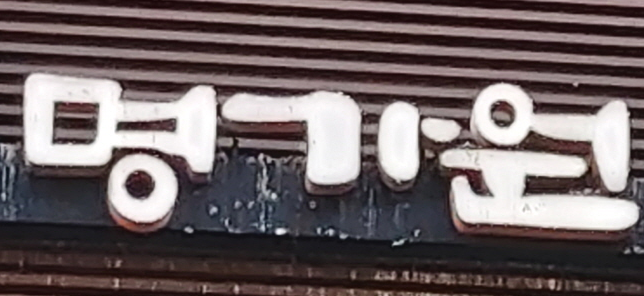

label: 명가원, a: 명기원, b: 명기원


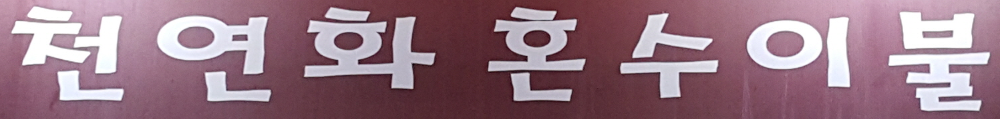

label: 천연화혼수이불, a: 천연화혼혼이불, b: 천연화혼혼수불불


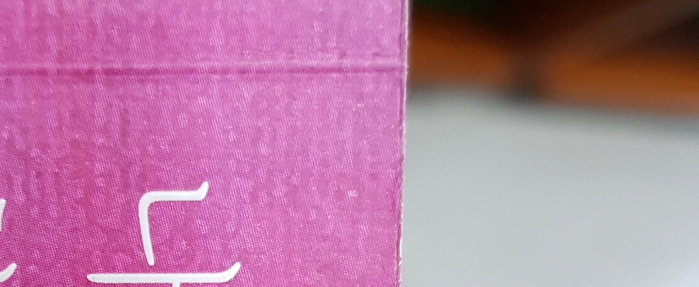

label: 나는엄마와, a: 나를, b: 나


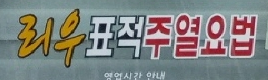

label: 리우표적지열요법, a: 리우표적주열요법, b: 리우표적주열요법


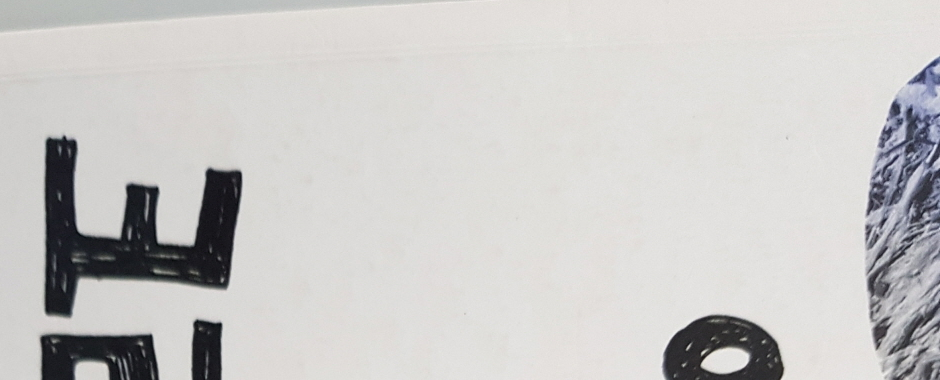

label: 예술가들에게, a: 크래장, b: 크르마


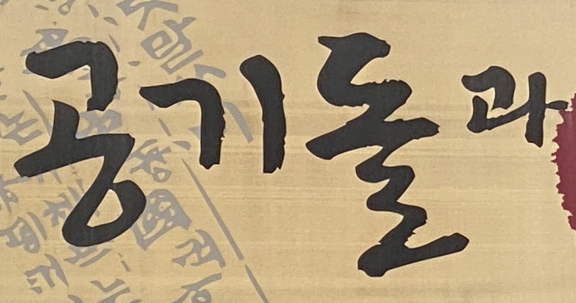

label: 공기돌과, a: 공기돌판, b: 공기돌파


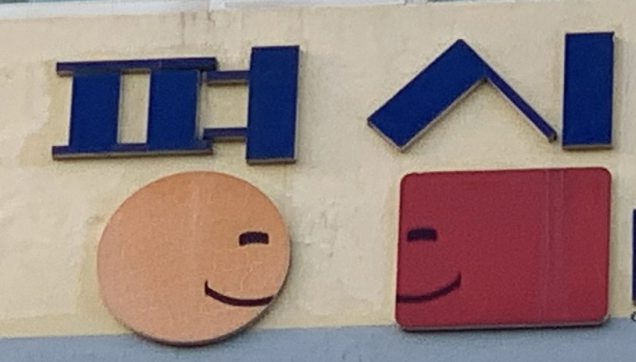

label: 평심, a: 평실, b: 평실


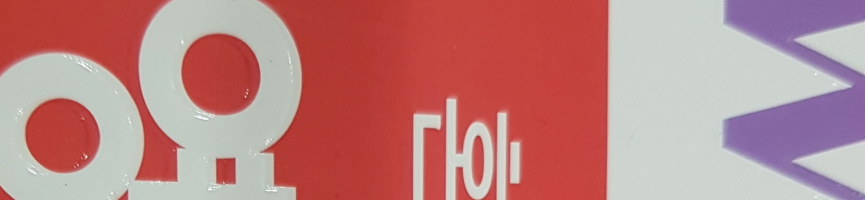

label: 혼자배우는, a: 영에세는, b: 영어이이


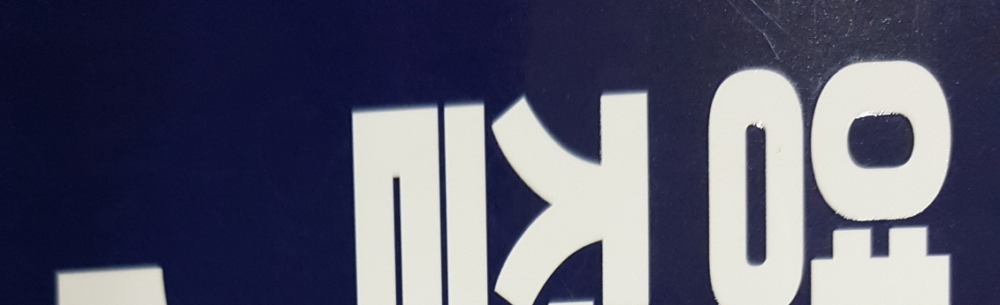

label: 영어말하기, a: 해세제찰, b: 일상가


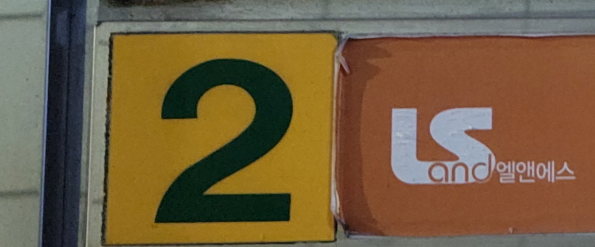

label: xxxx, a: 야, b: 소또


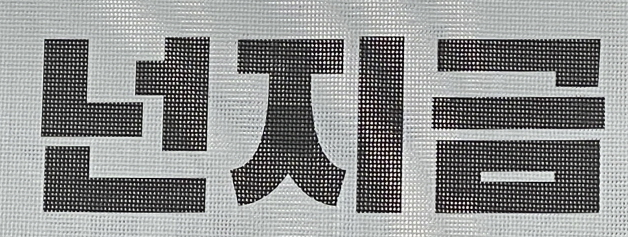

label: 넌지금, a: 번지금, b: 본지금


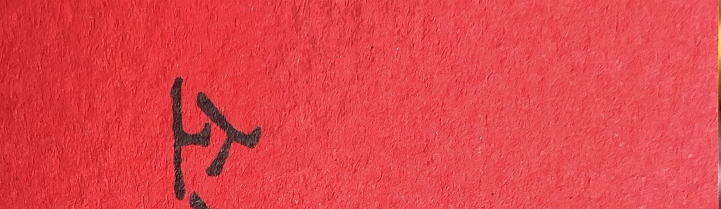

label: 소설거절술, a: 나람쥬려려다, b: 나과와사사


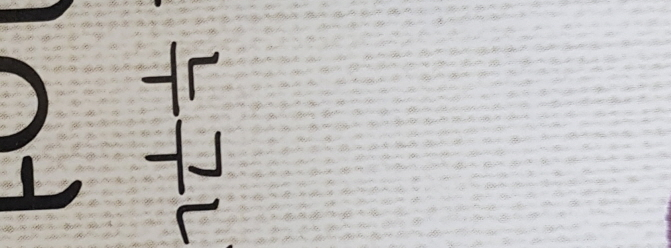

label: 귀여운, a: 엄마도름다, b: 모럽풀풀다


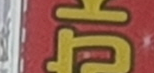

label: 체험관, a: 수식당, b: 삼기


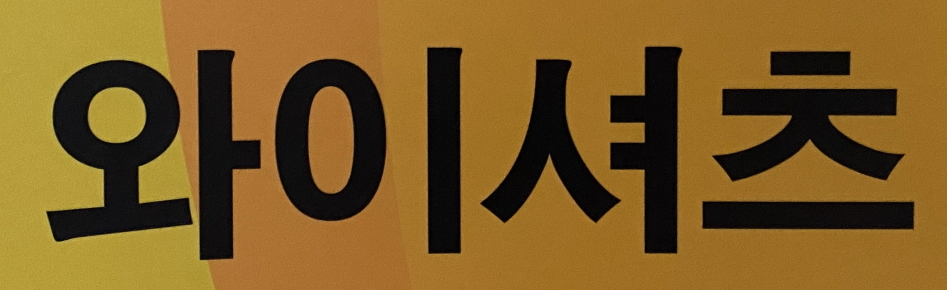

label: 와이셔츠, a: 와이져츠, b: 와이쳐츠


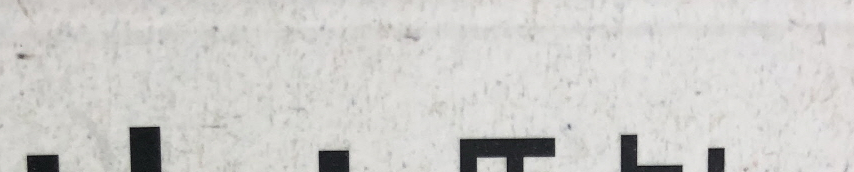

label: 교과서밖에서, a: 프트트트, b: 도기모모한


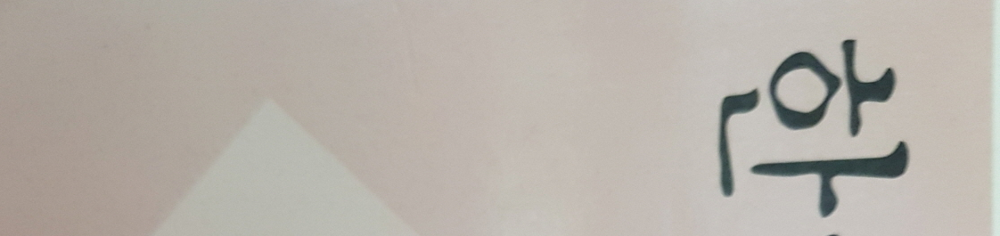

label: 한국근대간호사, a: 과학말다, b: 인대한사로기


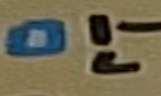

label: 만, a: 안, b: 안


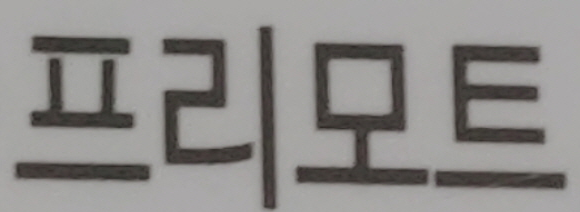

label: 프리모토, a: 프리모트, b: 프리모트


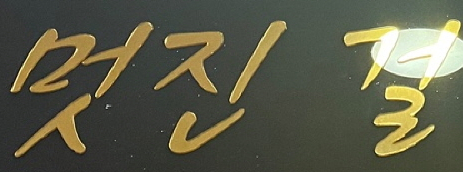

label: 멋진걸, a: 멋진결, b: 멋진


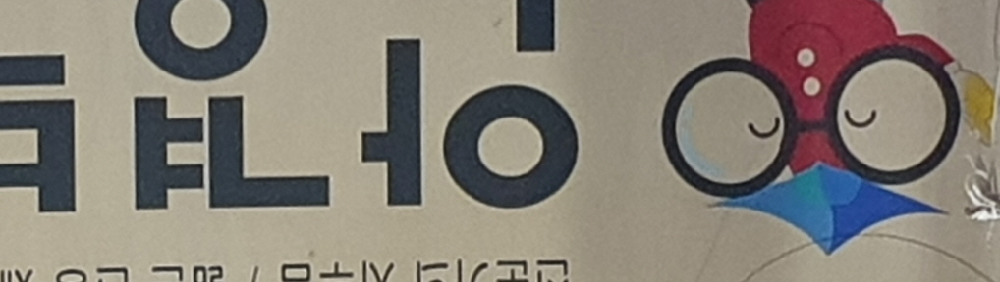

label: 안경박사, a: 인상인학, b: 새자정


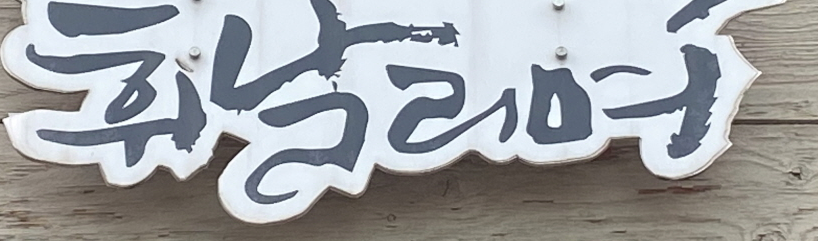

label: 휘날리며, a: 화날리여, b: 화남태어


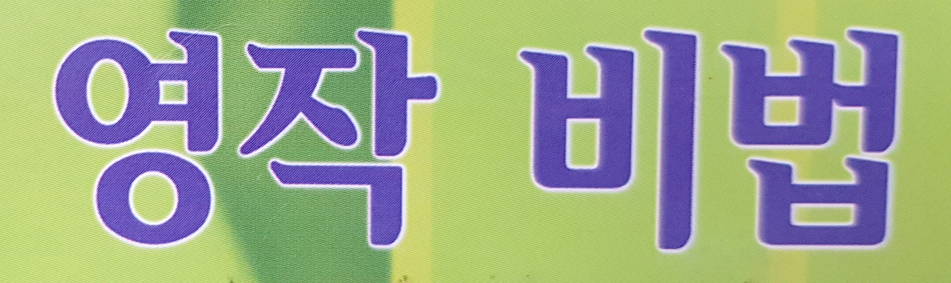

label: 영어비법, a: 영작비법, b: 영작비법


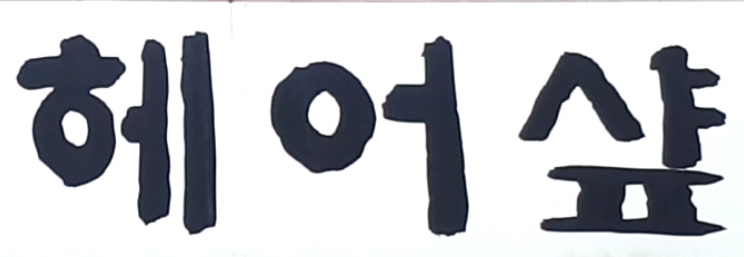

label: 헤어샾, a: 헤어, b: 헤어


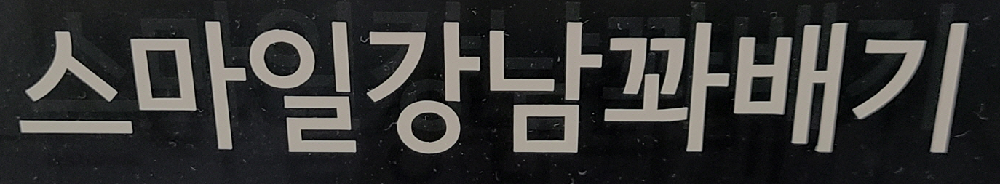

label: 스마일강남꽈배기, a: 스마일강남배기, b: 스마일강남배기


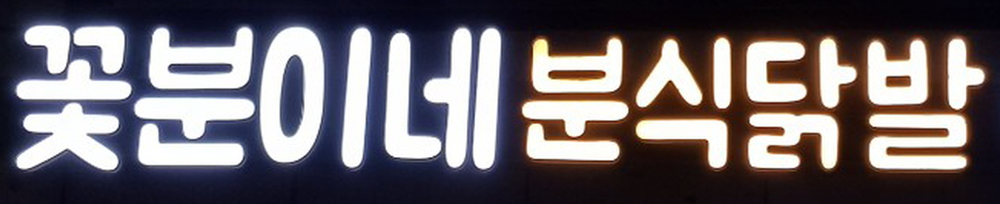

label: 꽂분이네분식닭발, a: 꽃분이네분식닭발, b: 꽃분이네분식닭발


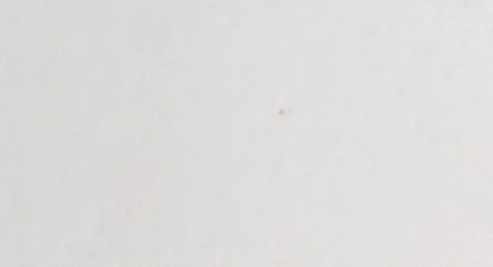

label: 지지, a: 간, b: 나


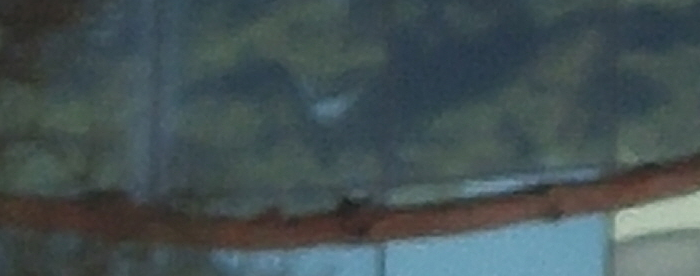

label: 테르시아, a: 돈가, b: 예사


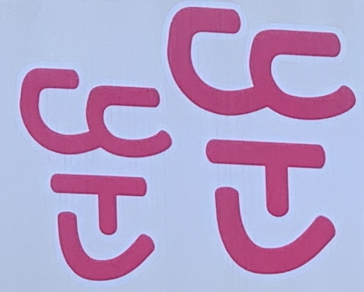

label: 뚠뚠, a: 눈눈, b: 운둔


In [158]:

for i, (image, label, a, b) in target_df[["image", "label", "A_align3", "B_align3"]][30:100].iterrows():
    Image.open(f"/home/datasets/{image}").show()
    print(f"label: {label}, a: {a}, b: {b}")



0.2222222222222222